# Analysis of the healthy human airway atlas

[Cells & Genes filtering](#Cells-&-Genes-filtering)  
Keep the 'high quality' cells identified from  the preliminary analysis / pre-processing steps.

#### Dimension reduction and embeddings
 + [PCA](#PCA)  
 + [UMAP](#UMAP)    
 
#### Clustering    
 + [Correlation between clusters](#Correlation-between-clusters)  
 + [Plot marker genes](#Plot-marker-genes)   
 + [Marker Genes](#Marker-Genes)   
 + [Cell Type labelling](#Cell-Type-labelling)   

In [1]:
# Import useful modules

import numpy as np
import pandas as pd
import scanpy as sc
import os
#import igraph
import matplotlib.pyplot as plt
import seaborn

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()


scanpy==1.4+39.gc70f24b anndata==0.6.18 numpy==1.16.2 scipy==1.2.1 pandas==0.24.1 scikit-learn==0.20.3 statsmodels==0.9.0 python-igraph==0.7.1 


In [2]:
sc.settings.set_figure_params(dpi=90)

### Cells & Genes filtering

In [4]:
adata = sc.read_h5ad('/data/PreProcessed_dataset.h5ad')

In [14]:
metadata = pd.read_csv('/Data/fastMNN_meta.txt', sep = '\t')
metadata.index.tolist()[0:10]
metadata.index = metadata['index']
metadata.index.tolist()[0:10]

['D322_Biop_Nas1_AGCGGTCGTCATACTG-1-0',
 'D322_Biop_Nas1_CGAGAAGGTGAAGGCT-1-0',
 'D322_Biop_Nas1_GGGACCTGTCTAACGT-1-0',
 'D322_Biop_Nas1_GACTACACAGTCCTTC-1-0',
 'D322_Biop_Nas1_GAACCTACACGGTTTA-1-0',
 'D322_Biop_Nas1_AGCTTGACACGTCTCT-1-0',
 'D322_Biop_Nas1_AGCTTGACAGCGTAAG-1-0',
 'D322_Biop_Nas1_TGCGCAGAGCGTAGTG-1-0',
 'D322_Biop_Nas1_GAGGTGAAGTGGGCTA-1-0',
 'D322_Biop_Nas1_TAGACCATCCGCATAA-1-0']

In [16]:
## Keep High Quality cells
list_of_cell_names = metadata.index.tolist()
adata = adata[list_of_cell_names, ]
adata.shape

(78144, 32568)

In [5]:
# Remove unwanted genes (mitochondrial genes)
genes_names = adata.var.index.tolist()
keep_genes = [i for i in genes_names if not i.startswith('MT-')]
adata = adata[:,keep_genes]

In [18]:
adata.raw = adata
adata.obs['n_counts_log'] = np.log10(adata.obs['n_counts'])

In [19]:
sc.pp.filter_genes(adata, min_cells=100)
adata.X.shape

filtered out 14138 genes that are detected in less than 100 cells


(78144, 18417)

--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


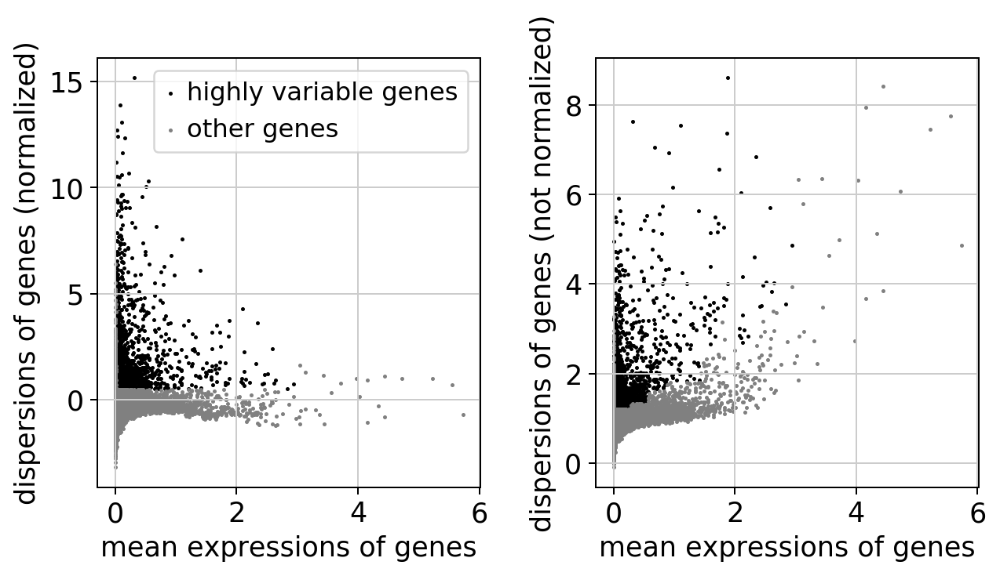

In [20]:
sc.pp.highly_variable_genes(adata, min_mean=0.01, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(adata)

In [21]:
np.sum(adata.var['highly_variable'])

2104

In [22]:
sc.pp.scale(adata, max_value=10)

### PCA

In [23]:
sc.tl.pca(adata, svd_solver='arpack')

In [27]:
# Load fastMNN PCA (Data integration results)
pca = pd.read_csv('/Data/fastMNN_PCA.txt', sep = '\t')
pca.index = metadata.index

In [31]:
adata.obsm['X_pca'].shape

(78144, 50)

In [38]:
pca_numpy = pca.as_matrix()
pca_numpy.shape

/home/deprez/environments/env_HCA/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  """Entry point for launching an IPython kernel.


(78144, 50)

In [39]:
adata.obsm['X_pca'] = pca_numpy

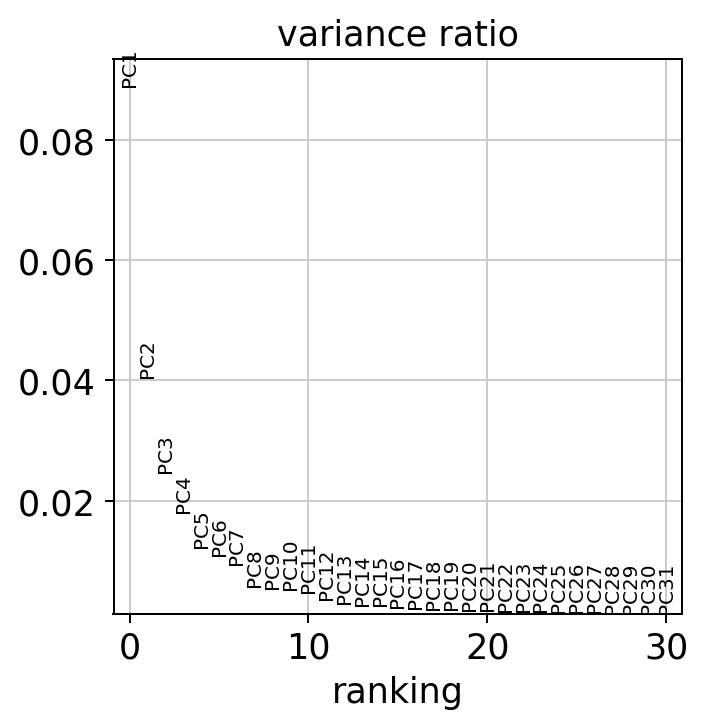

In [40]:
sc.pl.pca_variance_ratio(adata, log = False)

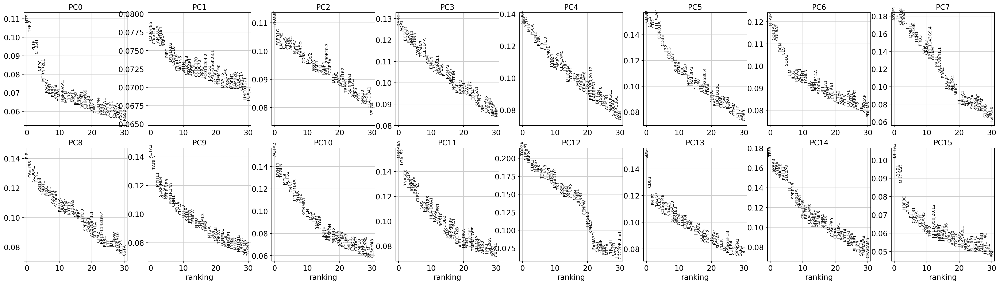

In [41]:
sc.pl.pca_loadings(adata, components=list(range(0,16)))

***
# Embeddings
### Umap

In [145]:
sc.pp.neighbors(adata, n_neighbors=100, n_pcs=12)

computing neighbors
    using 'X_pca' with n_pcs = 12
    finished (0:01:24.79) --> added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix


In [146]:
sc.tl.umap(adata)

computing UMAP
    finished (0:02:49.02) --> added
    'X_umap', UMAP coordinates (adata.obsm)


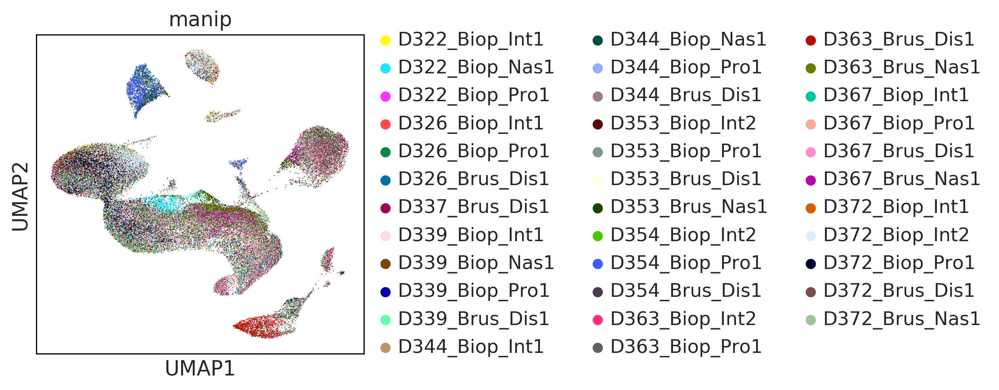

In [147]:
sc.pl.umap(adata, color=['manip'],edges = False)

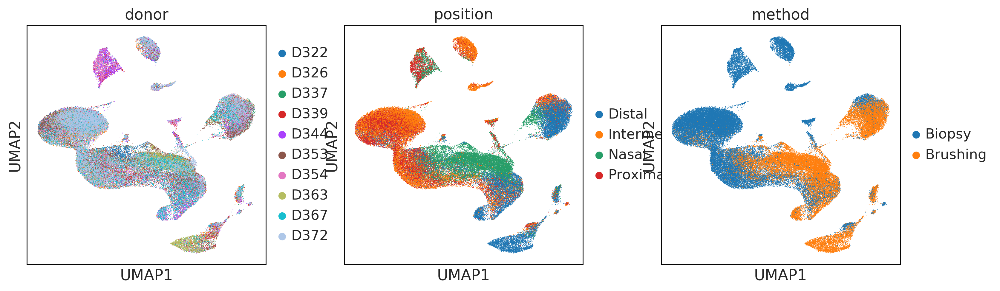

In [148]:
sc.pl.umap(adata, color=['donor','position','method'],edges = False)

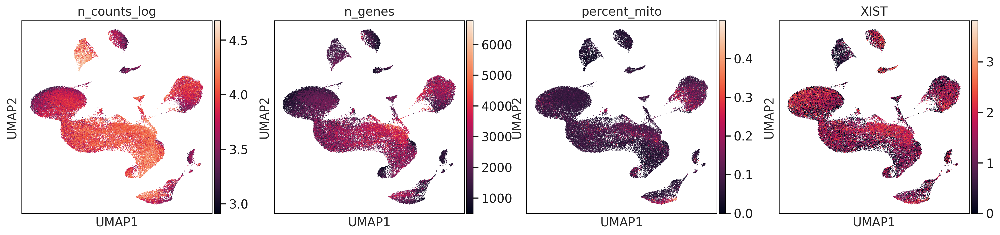

In [149]:
sc.pl.umap(adata, color=['n_counts_log', 'n_genes', 'percent_mito', "XIST"],edges = False)

... storing 'previous_cell_type' as categorical


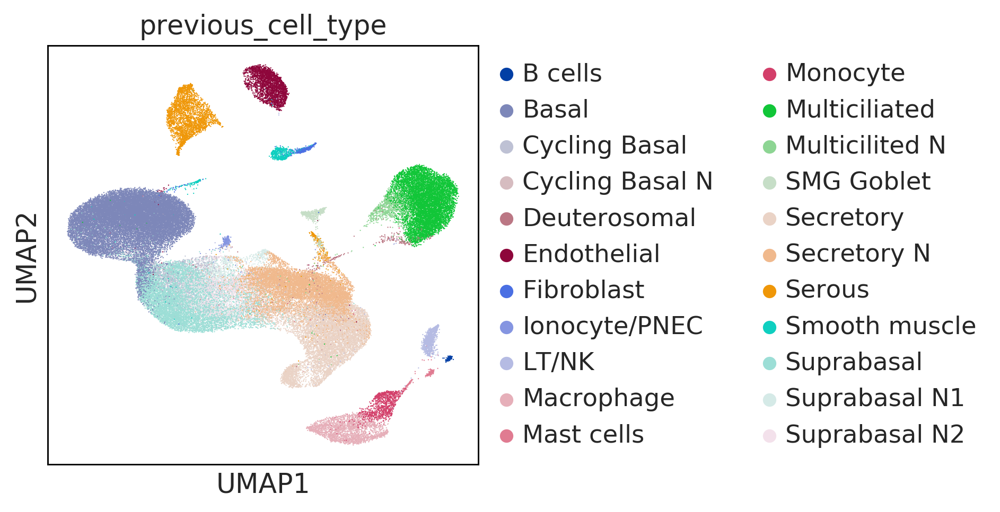

In [150]:
adata.obs['previous_cell_type'] = metadata['cell_type']
sc.pl.umap(adata, color=['previous_cell_type'],edges = False)

## t-SNE

In [151]:
sc.tl.tsne(adata, n_pcs = 8, perplexity = 100)

computing tSNE
    using 'X_pca' with n_pcs = 8
    using the 'MulticoreTSNE' package by Ulyanov (2017)
    finished (0:18:02.00) --> added
    'X_tsne', tSNE coordinates (adata.obsm)


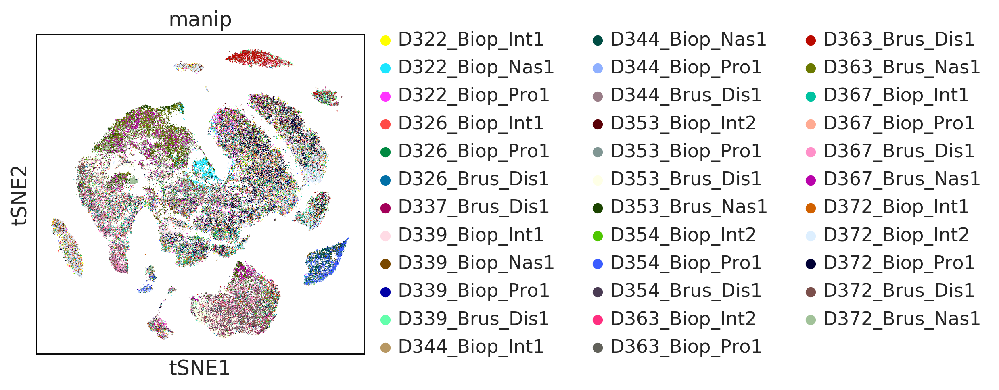

In [152]:
sc.pl.tsne(adata, color=['manip'])

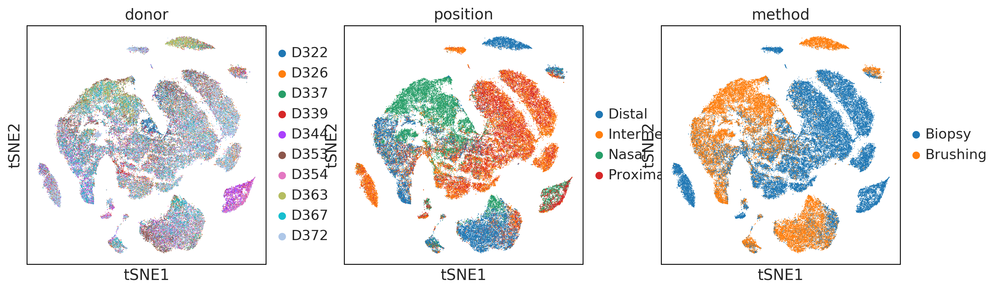

In [155]:
sc.pl.tsne(adata, color=['donor','position','method'])

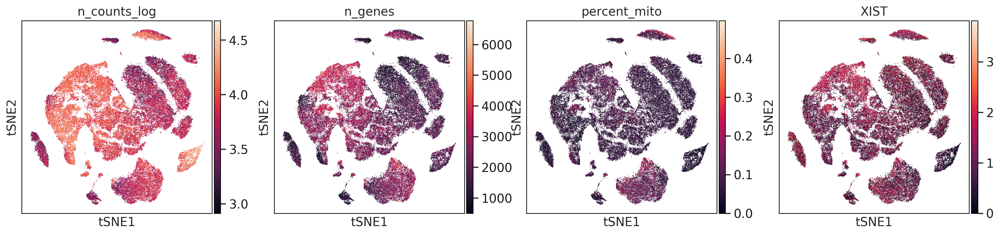

In [156]:
sc.pl.tsne(adata, color=['n_counts_log', 'n_genes', 'percent_mito', "XIST"])

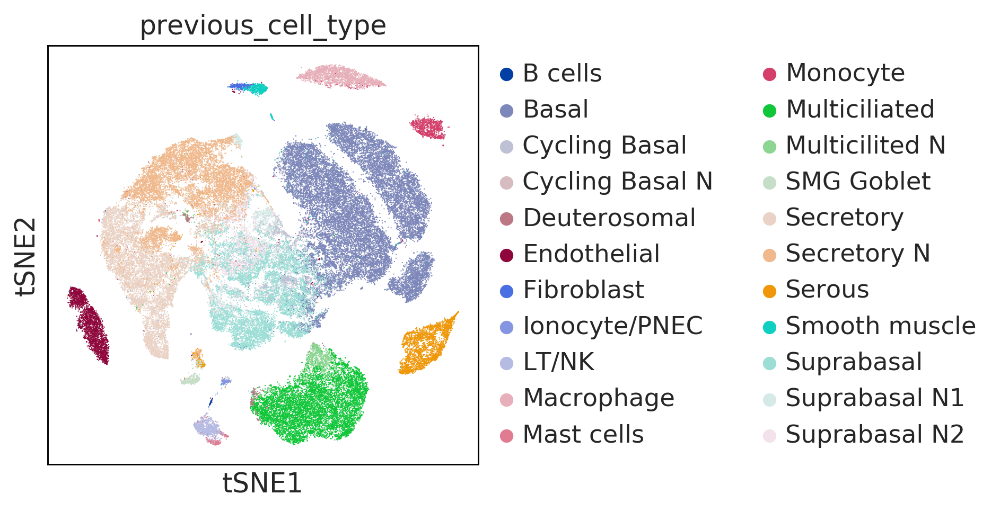

In [154]:
sc.pl.tsne(adata, color=['previous_cell_type'])

***
# Clustering

Two round of clustering are performed to best isolate small clusters / 'rare' cells

In [73]:
communities, graph, Q = sc.external.tl.phenograph(adata.obsm['X_pca'][:,0:12], k=100)

PhenoGraph clustering
Finding 100 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 42.62300252914429 seconds
Jaccard graph constructed in 43.35295915603638 seconds
Wrote graph to binary file in 26.61650514602661 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.88261
Louvain completed 21 runs in 173.26633405685425 seconds
PhenoGraph complete in 286.6609456539154 seconds
    finished (0:04:50.04)


In [74]:
adata.obs['phenograph'] = pd.Categorical(communities)

In [75]:
pd.Categorical(communities)

[9, 9, 9, 9, 9, ..., 1, 4, 4, 15, 4]
Length: 78144
Categories (23, int64): [0, 1, 2, 3, ..., 19, 20, 21, 22]

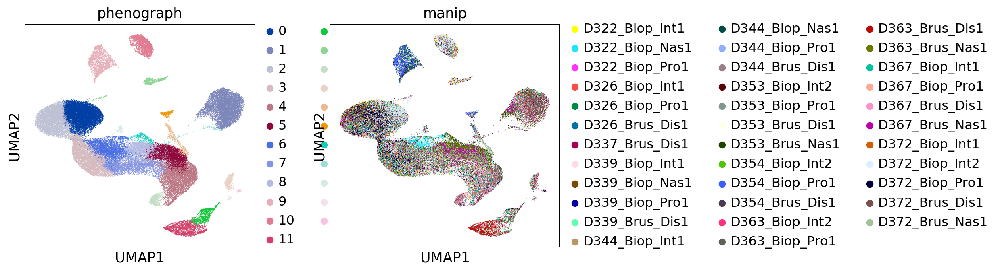

In [76]:
sc.pl.umap(adata, color=['phenograph', 'manip'])

In [82]:
communities, graph, Q = sc.external.tl.phenograph(adata.obsm['X_pca'][:,0:25], k=10)

PhenoGraph clustering
Finding 10 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 46.34259009361267 seconds
Jaccard graph constructed in 2.7584497928619385 seconds
Wrote graph to binary file in 1.249180555343628 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.911184
After 3 runs, maximum modularity is Q = 0.912453
Louvain completed 23 runs in 23.977067232131958 seconds
PhenoGraph complete in 74.39763808250427 seconds
    finished (0:01:24.25)


In [83]:
adata.obs['phenograph_2'] = pd.Categorical(communities)

In [84]:
pd.Categorical(communities)

[15, 15, 15, 15, 15, ..., 3, 4, 4, 19, 19]
Length: 78144
Categories (44, int64): [-1, 0, 1, 2, ..., 39, 40, 41, 42]

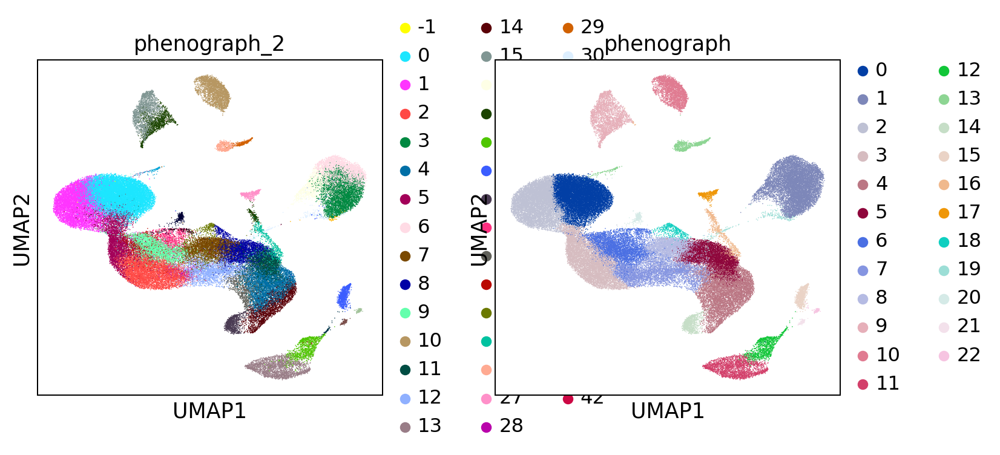

In [85]:
sc.pl.umap(adata, color=['phenograph_2', 'phenograph'])

## Correlation between clusters

In [86]:
mean_cellType = np.empty((len(adata.obs['phenograph'].unique()), adata.raw.shape[1]), 
                           dtype=float, order='C')

In [87]:
raw_adata = adata.raw.X.toarray()

In [88]:
for i in range(0, len(adata.obs['phenograph'].unique())):
    mean_cellType[i,:] = np.mean(raw_adata[adata.obs['phenograph'] == adata.obs['phenograph'].unique()[i], :], axis = 0)

In [89]:
mean_df = pd.DataFrame(np.corrcoef(mean_cellType), index = adata.obs['phenograph'].unique(), columns = adata.obs['phenograph'].unique())

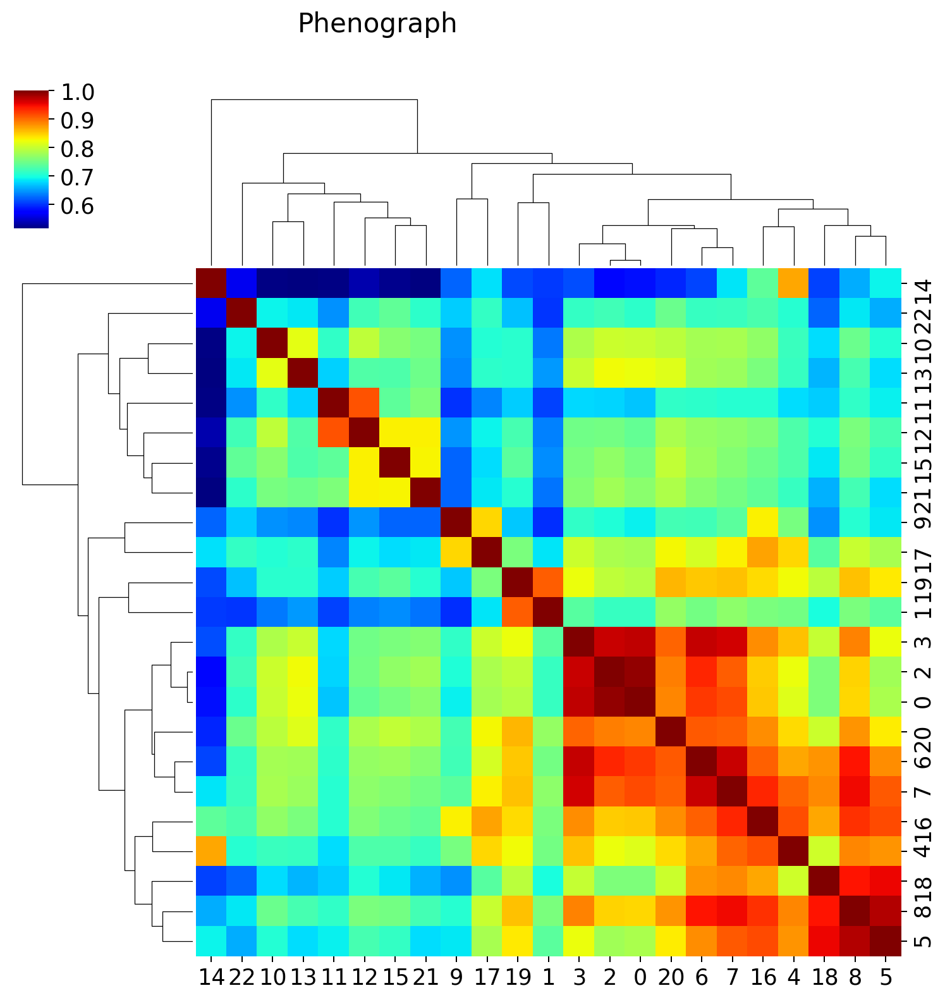

In [90]:
ax = seaborn.clustermap(mean_df, cmap="jet").fig.suptitle('Phenograph') 

In [91]:
mean_cellType = np.empty((len(adata.obs['phenograph_2'].unique()), adata.raw.shape[1]), 
                           dtype=float, order='C')

In [92]:
for i in range(0, len(adata.obs['phenograph_2'].unique())):
    mean_cellType[i,:] = np.mean(raw_adata[adata.obs['phenograph_2'] == adata.obs['phenograph_2'].unique()[i], :], axis = 0)

In [93]:
mean_df = pd.DataFrame(np.corrcoef(mean_cellType), index = adata.obs['phenograph_2'].unique(), columns = adata.obs['phenograph_2'].unique())

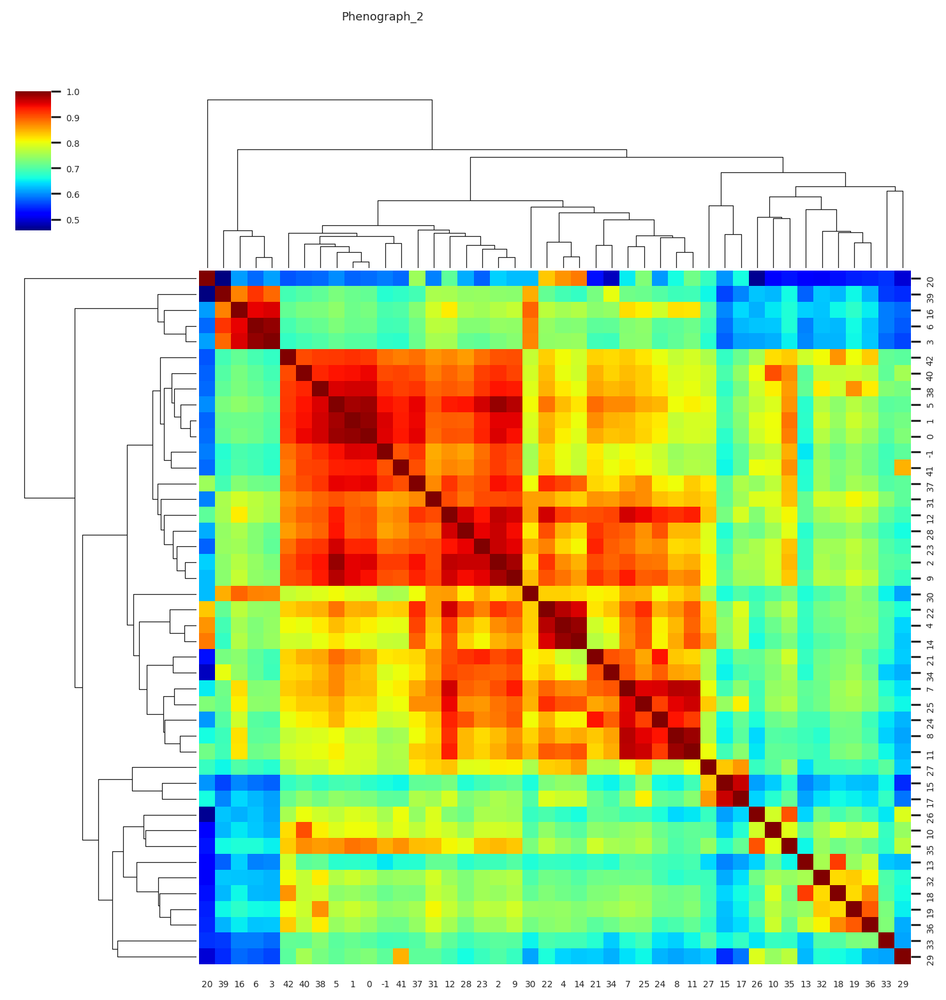

In [94]:
seaborn.set(font_scale=0.5)
ax = seaborn.clustermap(mean_df, cmap="jet").fig.suptitle('Phenograph_2') 

In [95]:
seaborn.set_style("white")

## Plot marker genes

Marker genes identified during the individual analysis of each sample.

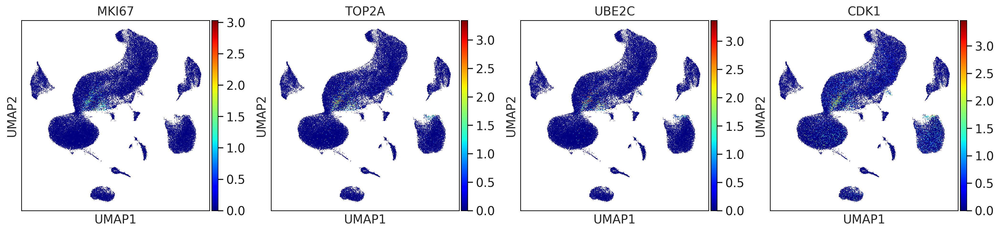

In [129]:
sc.pl.umap(adata, color=['MKI67', 'TOP2A', 'UBE2C', 'CDK1'], color_map="jet") # Cycling Basal

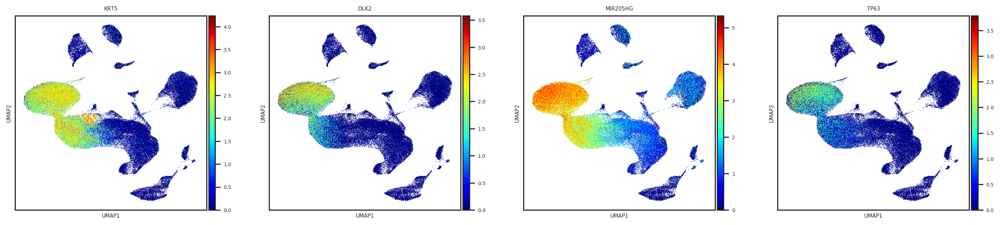

In [97]:
sc.pl.umap(adata, color=['KRT5', 'DLK2', 'MIR205HG', 'TP63'], color_map="jet") # Basal

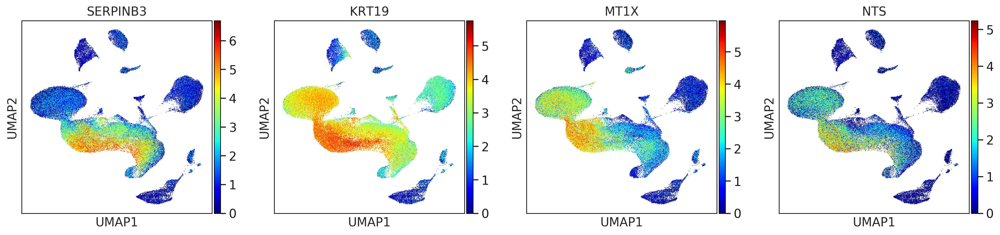

In [160]:
sc.pl.umap(adata, color=['SERPINB3', 'KRT19', 'MT1X', 'NTS'], color_map="jet") # Suprabasal 

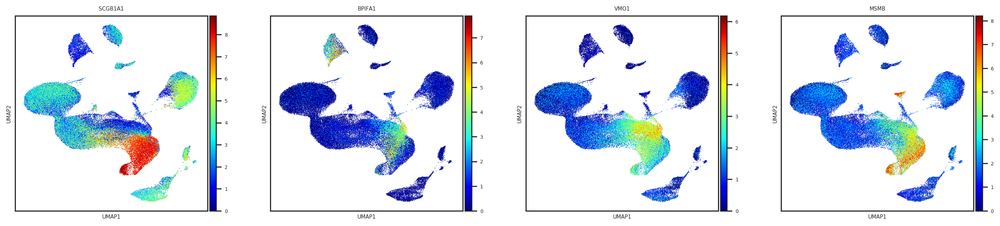

In [99]:
sc.pl.umap(adata, color=['SCGB1A1', 'BPIFA1', 'VMO1', 'MSMB'], color_map="jet") # Secretory

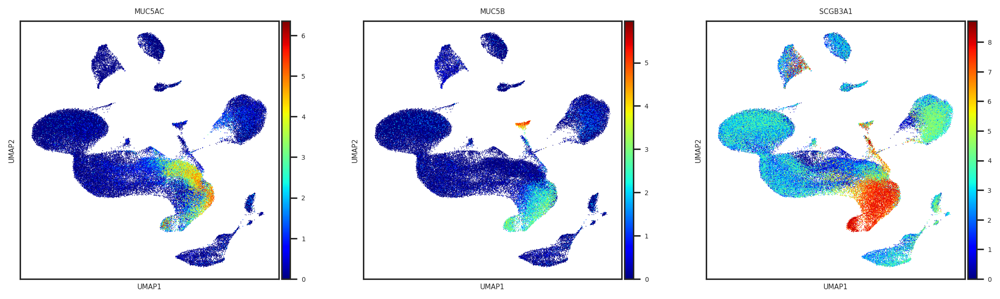

In [100]:
sc.pl.umap(adata, color=['MUC5AC', 'MUC5B', 'SCGB3A1'], color_map="jet") # Secretory

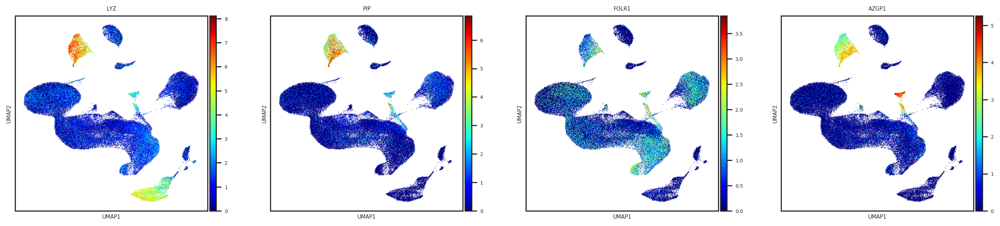

In [101]:
sc.pl.umap(adata, color=['LYZ', 'PIP', 'FOLR1', 'AZGP1'], color_map="jet") # Glandular

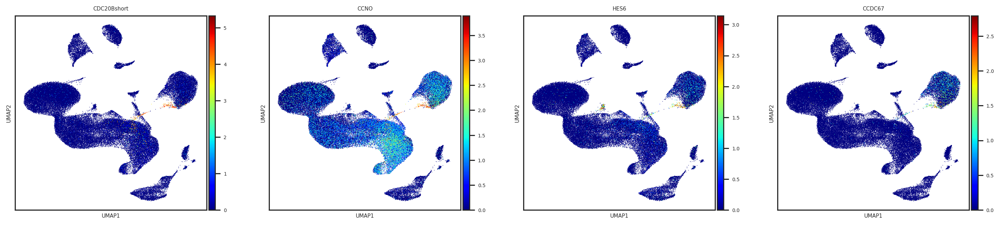

In [102]:
sc.pl.umap(adata, color=['CDC20Bshort', 'CCNO', 'HES6', 'CCDC67'], color_map="jet") # Deuterosomal

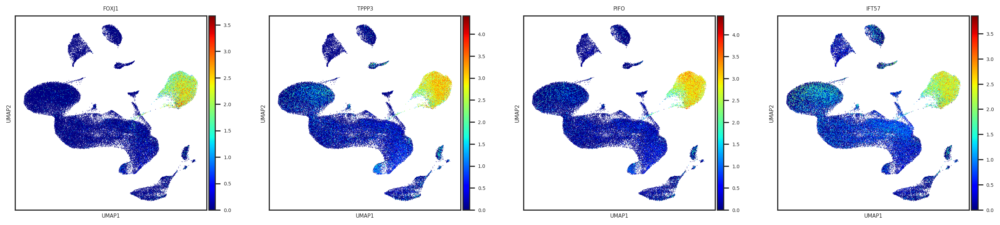

In [103]:
sc.pl.umap(adata, color=['FOXJ1', 'TPPP3', 'PIFO', 'IFT57'], color_map="jet") # Multiciliated

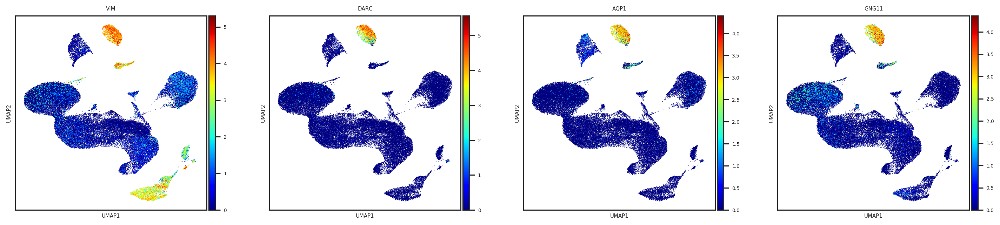

In [105]:
sc.pl.umap(adata, color=['VIM', 'DARC', 'AQP1', 'GNG11'], color_map="jet") # Endothelial

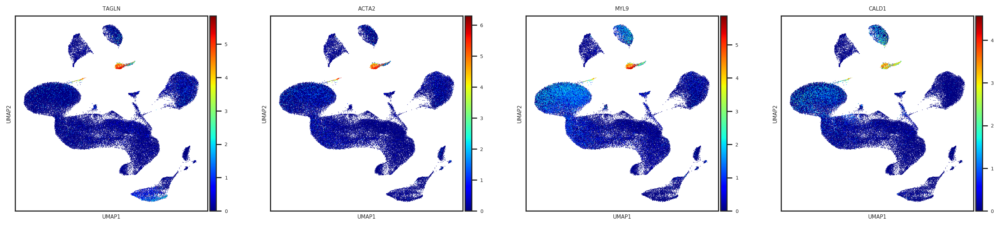

In [106]:
sc.pl.umap(adata, color=['TAGLN', 'ACTA2', 'MYL9', 'CALD1'], color_map="jet") # Smooth muscle

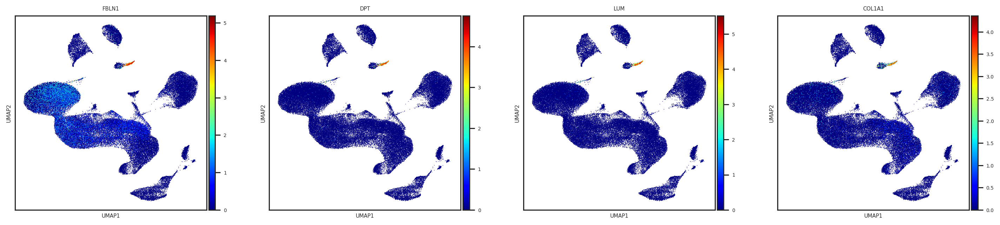

In [107]:
sc.pl.umap(adata, color=['FBLN1', 'DPT', 'LUM', 'COL1A1'], color_map="jet") # Fibroblast

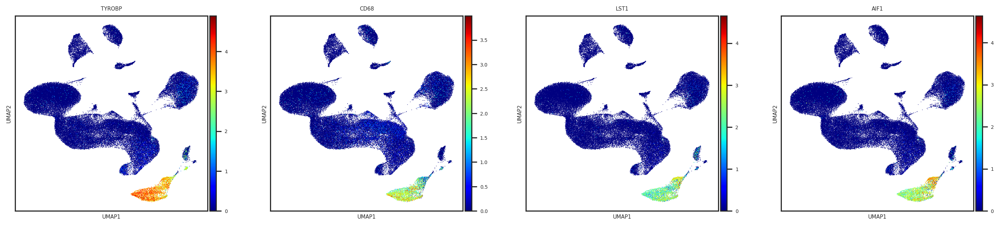

In [108]:
sc.pl.umap(adata, color=['TYROBP', 'CD68', 'LST1', 'AIF1'], color_map="jet") # Macrophage

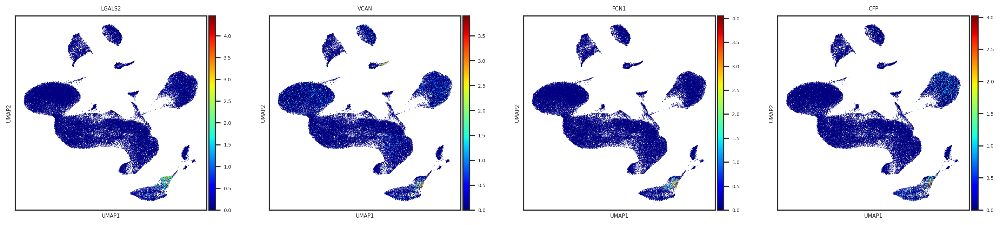

In [109]:
sc.pl.umap(adata, color=['LGALS2', 'VCAN', 'FCN1', 'CFP'], color_map="jet") # Monocytes

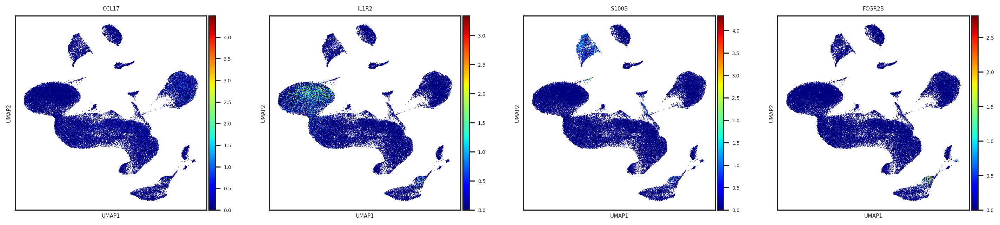

In [110]:
sc.pl.umap(adata, color=['CCL17', 'IL1R2', 'S100B', 'FCGR2B'], color_map="jet") # Dendritic cells

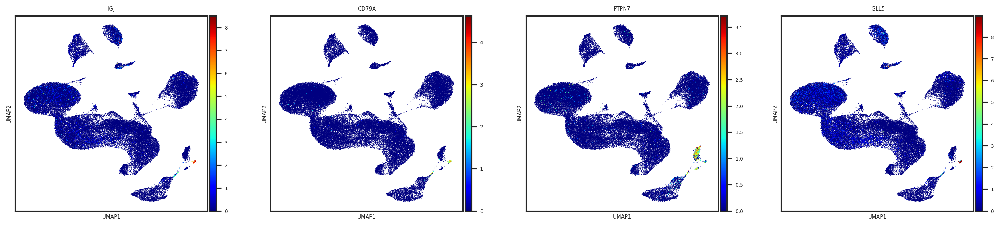

In [111]:
sc.pl.umap(adata, color=['IGJ', 'CD79A', 'PTPN7', 'IGLL5'], color_map="jet") # B cells

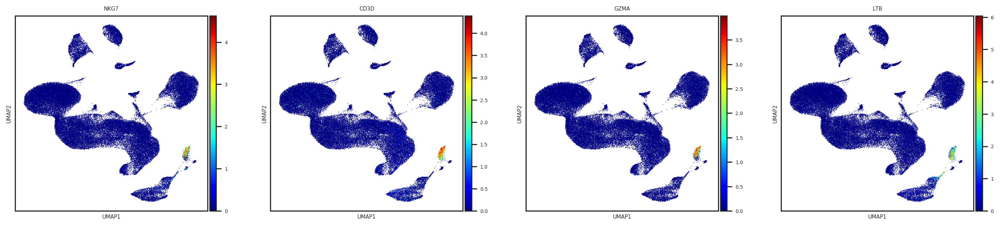

In [112]:
sc.pl.umap(adata, color=['NKG7', 'CD3D', 'GZMA', 'LTB'], color_map="jet") # LT/NK

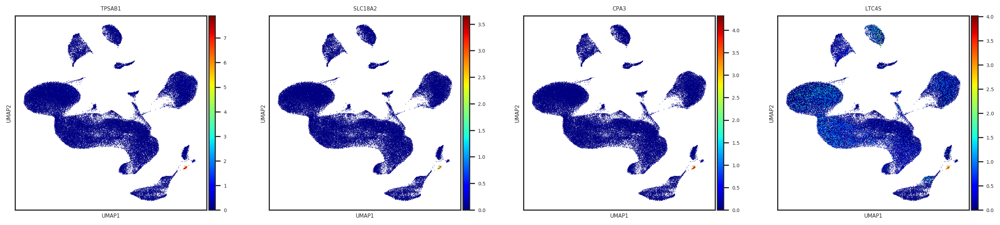

In [113]:
sc.pl.umap(adata, color=['TPSAB1', 'SLC18A2', 'CPA3', 'LTC4S'], color_map="jet") # Mast cells

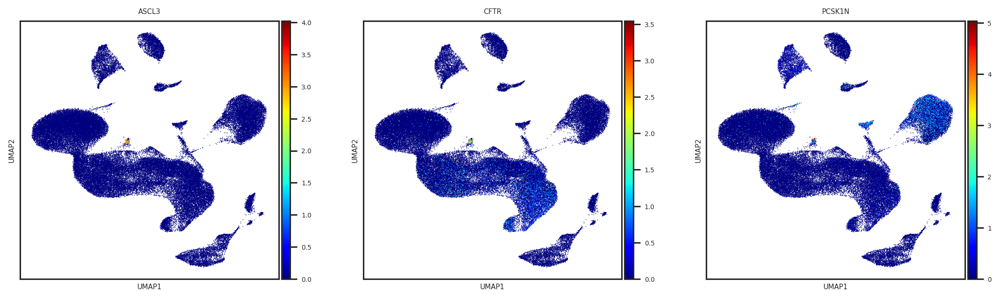

In [104]:
sc.pl.umap(adata, color=['ASCL3', 'CFTR', 'PCSK1N'], color_map="jet") # Ionocyte / PNEC - , 'SCG5'

## Identification of Marker Genes

Wilcoxon's rank test (one-VS-all differential expression testing design)

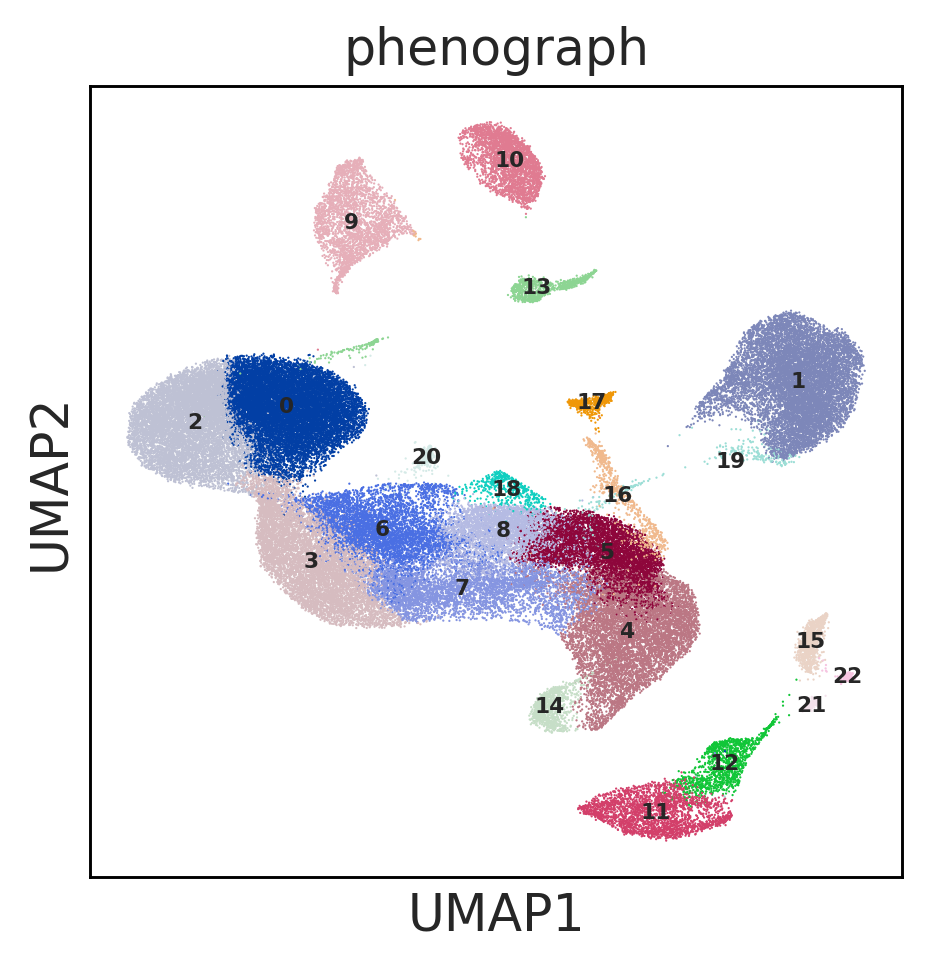

In [114]:
sc.settings.set_figure_params(dpi=130)
sc.pl.umap(adata, color=['phenograph'], legend_loc = 'on data', legend_fontsize = 6)

In [116]:
sc.tl.rank_genes_groups(adata, groupby = 'phenograph', method='wilcoxon')

ranking genes
    finished (0:05:18.92) --> added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids


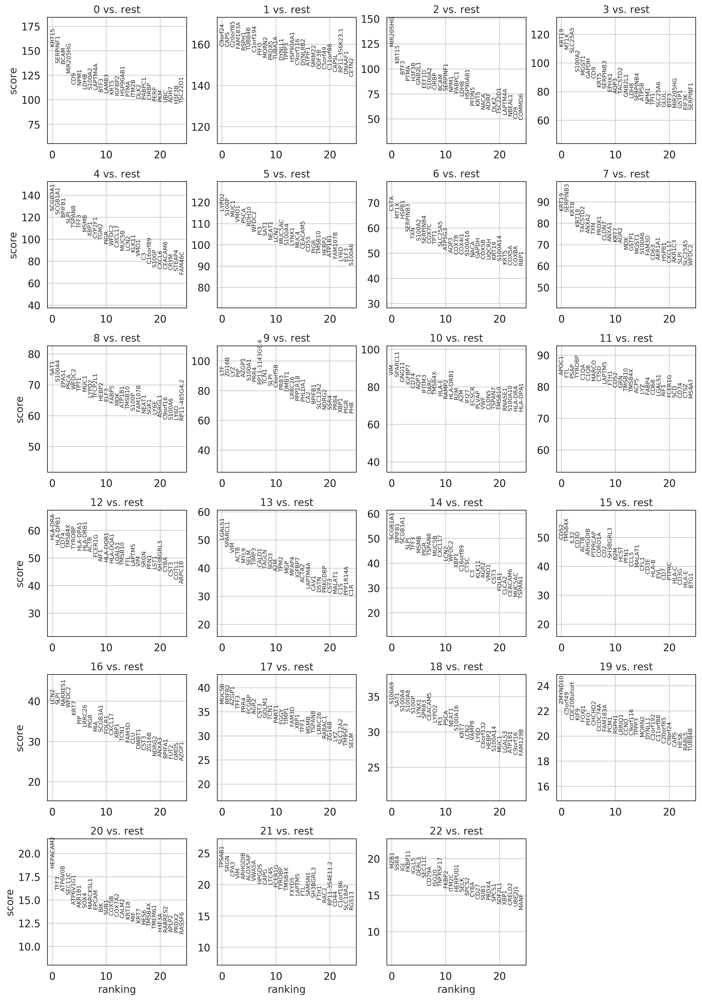

In [117]:
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [118]:
sc.tl.rank_genes_groups(adata, groupby = 'phenograph_2', method='wilcoxon')

ranking genes
    finished (0:06:57.93) --> added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids


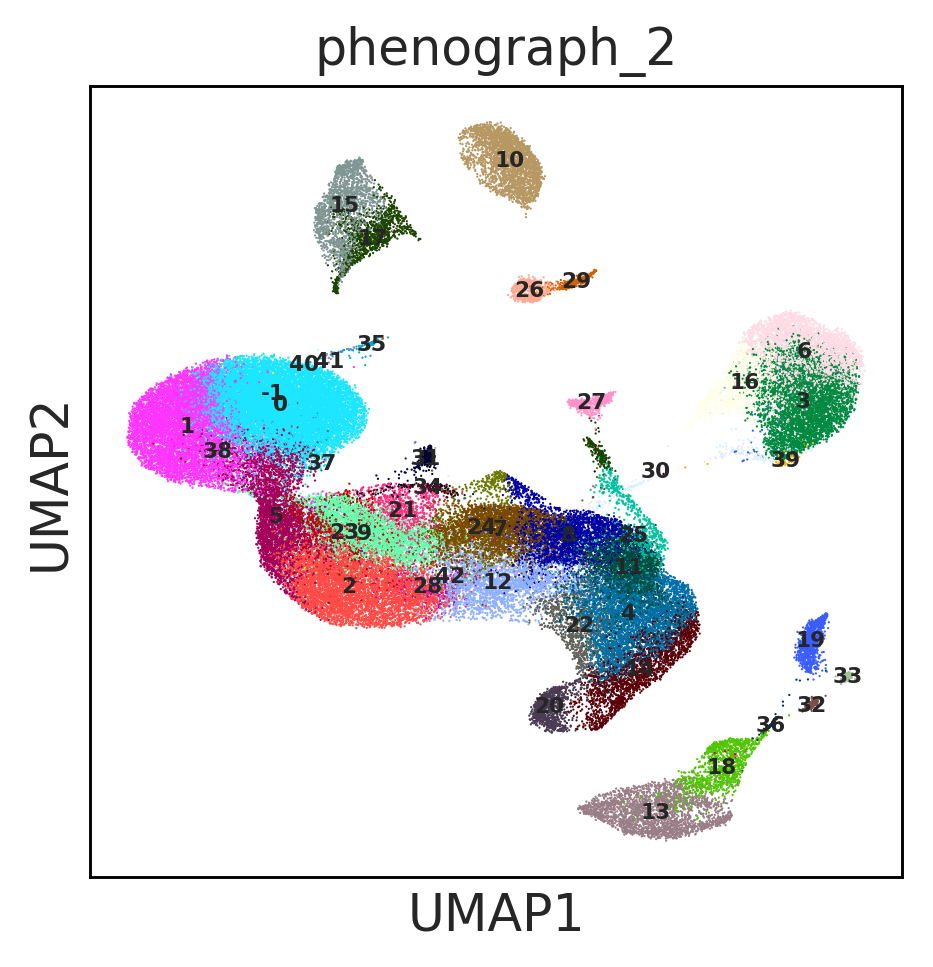

In [115]:
sc.pl.umap(adata, color=['phenograph_2'], legend_loc = 'on data', legend_fontsize = 6)

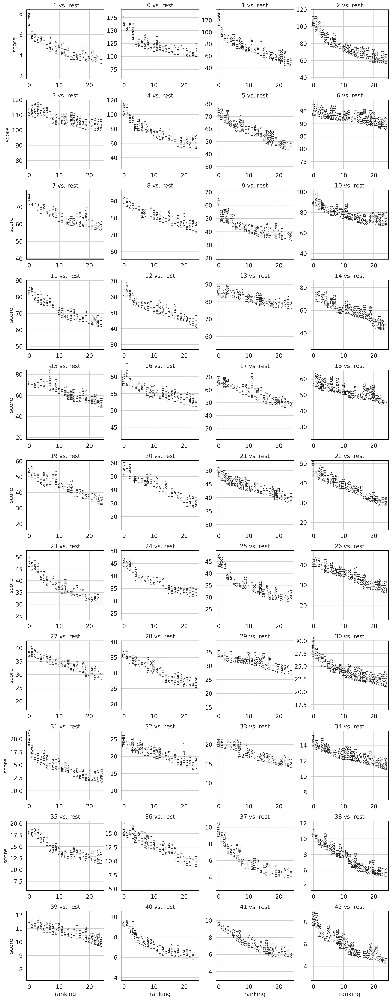

In [119]:
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

## Cell Type labelling

In [181]:
new_cluster_names = {
    '0':'Basal', '1':'Multiciliated', '2':'Basal', '3':'Suprabasal', '4':'Secretory', # 0-4
    '5':'Secretory N','6':'Suprabasal', '7':'Suprabasal', '8':'Suprabasal N', '9':'Serous', # 5-9
    '10':'Endothelial', '11':'Macrophage', '12':'Monocyte', '13':'Smooth muscle', '14':'Secretory', # 10-14
    '15':'LT/NK', '16':'Secretory N', '17':'SMG Goblet', '18':'Suprabasal N', '19':'Deuterosomal', # 15-19
    '20':'Rare cells', '21':'Mast cells', '22':'B cells'}

new_small_cluster_names = {
    '19':'LT/NK', '18':'Monocyte', '32':'Mast cells', '33':'B cells', '36':'Plasma cells',  
    '26':'Smooth muscle', '29':'Fibroblast', '34':'Rare cells',
    '35': 'doublet', '40':'doublet', '41':'doublet'}


In [182]:
vect = []
for i in range(0, len(adata.obs['phenograph'])):
    if (str(adata.obs['phenograph_2'][i]) in new_small_cluster_names.keys()) :
        vect = vect + [new_small_cluster_names[str(adata.obs['phenograph_2'][i])]]
    else :
        vect = vect + [new_cluster_names[str(adata.obs['phenograph'][i])]]
    
adata.obs['cell_type'] = vect

In [183]:
## Last identification of peculiar cells supposed to be doublet cells.

list_cell_names = adata.obs.loc[adata.obs['cell_type'] != 'doublet', ].index.tolist()
adata = adata[list_cell_names, ]

In [186]:
adata.uns['cell_type_colors'] = [ '#7e6384',# B cells '#7e6384'
                                '#A31E22',   #, Basal , 
                                #'#db3d42',# Basal D
                                #'#F3766E', # Cycling Basal,
                                '#2da9d2', # Deuterosomal
                                '#281c1c', '#aea9ce', # Endothelial, Fibroblast
                                #'#006600', # Goblet
                                '#ff1aff', '#c997e7', #LT/NK, Macrophage
                                '#e366ff',  #Mast cells
                                 '#ca81ca', #Monocyte
                                '#466cb9', #'#90a7d5',# Multiciliated
                                 "#ca81ca", #Plasma cells
                                 '#b34d6d', # Rare cells
                                '#5edbbd', # SMG Goblet
                                '#53c653', '#a9c653', # Secretory
                                 '#3e937f', # Serous
                                '#7c5959', # Smooth muscle
                                '#FCCC0A', '#e0c96c'] # Suprabasal, '#ecec13'

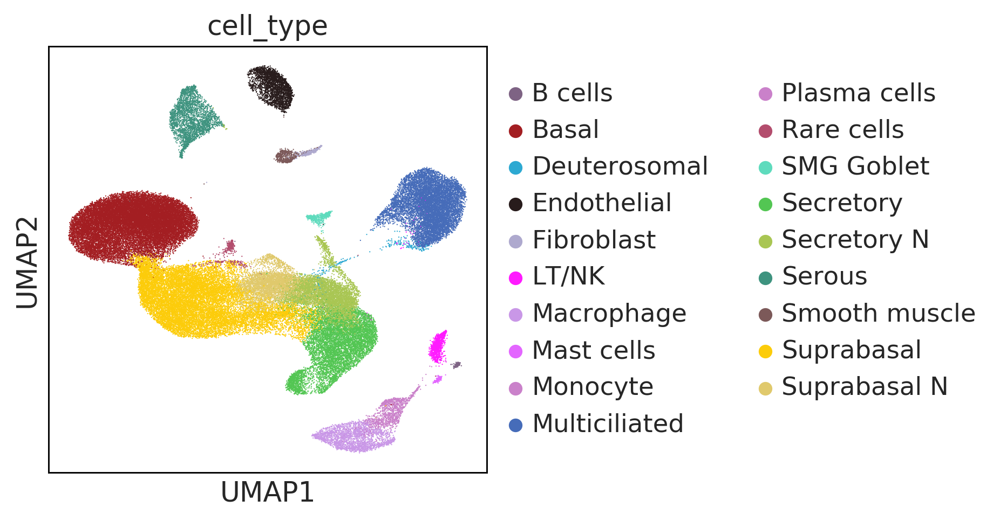

In [187]:
sc.pl.umap(adata, color=['cell_type'])

In [191]:
cell_type_nb = {}
list_cell_type = adata.obs['cell_type'].unique().tolist()
list_cell_type.sort()
for i in range(0, len(adata.obs['cell_type'].unique().tolist())):
    cell_type_nb[list_cell_type[i]] = i
cell_type_nb
 

{'B cells': 0,
 'Basal': 1,
 'Deuterosomal': 2,
 'Endothelial': 3,
 'Fibroblast': 4,
 'LT/NK': 5,
 'Macrophage': 6,
 'Mast cells': 7,
 'Monocyte': 8,
 'Multiciliated': 9,
 'Plasma cells': 10,
 'Rare cells': 11,
 'SMG Goblet': 12,
 'Secretory': 13,
 'Secretory N': 14,
 'Serous': 15,
 'Smooth muscle': 16,
 'Suprabasal': 17,
 'Suprabasal N': 18}

In [192]:
vect = []
for i in range(0, len(adata.obs['cell_type'])):
    vect = vect + [str(cell_type_nb[str(adata.obs['cell_type'][i])])]
    
adata.obs['cell_type_nb'] = vect

... storing 'cell_type_nb' as categorical
DEBUG:matplotlib.axes._base:update_title_pos
DEBUG:matplotlib.axes._base:update_title_pos
DEBUG:matplotlib.axes._base:update_title_pos
DEBUG:matplotlib.axes._base:update_title_pos


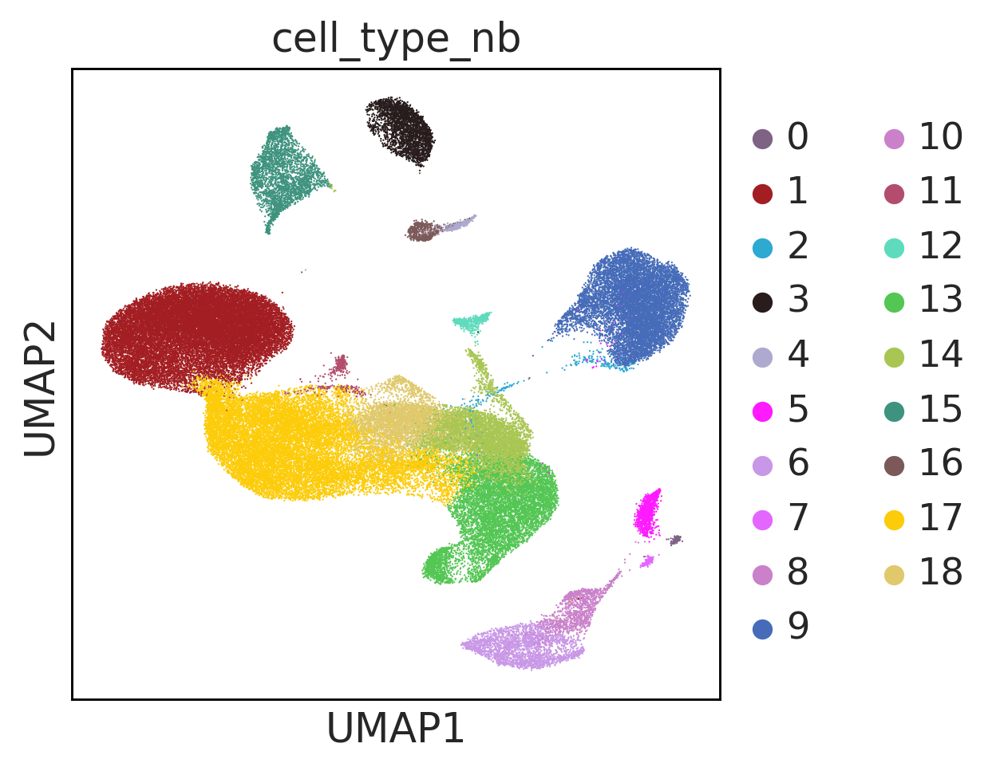

In [193]:
adata.uns['cell_type_nb_colors'] = adata.uns['cell_type_colors']
sc.pl.umap(adata, color=['cell_type_nb'])

In [194]:
sc.tl.rank_genes_groups(adata, groupby = 'cell_type_nb', method='wilcoxon', n_genes = 1000)

ranking genes
    finished (0:05:53.29) --> added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids


In [189]:
adata.write('/Data/Annotated_dataset_v1.h5ad')

***
## Top marker genes table.

In [200]:
inverted_cell_type_nb = dict([[v,k] for k,v in cell_type_nb.items()])

In [201]:
clusters = []
genes = []
logFC = []
score = []
pvals = []
pvals_adj = []

for cl in inverted_cell_type_nb.keys():
    clusters = clusters + ([inverted_cell_type_nb[cl]]*len(adata.uns['rank_genes_groups']['names'][str(cl)]))
    genes = genes + adata.uns['rank_genes_groups']['names'][str(cl)].tolist()
    logFC = logFC + adata.uns['rank_genes_groups']['logfoldchanges'][str(cl)].tolist()
    score = score + adata.uns['rank_genes_groups']['scores'][str(cl)].tolist()
    pvals = pvals + adata.uns['rank_genes_groups']['pvals'][str(cl)].tolist()
    pvals_adj = pvals_adj + adata.uns['rank_genes_groups']['pvals_adj'][str(cl)].tolist()
    
    
markers = pd.DataFrame(data = {'clusters': clusters,
                              'genes':genes,
                              'logFC':logFC,
                              'score':score,
                              'pvals':pvals,
                              'pvals_adj':pvals_adj,
                              })

In [202]:
markers.to_csv(path_or_buf = '/Data/markers_v1.tsv', 
               sep = '\t', index = False)
